# Conditional Variational Autoencoder (CVAE)

## Import statements + Device

In [1]:
import torch
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import torchvision.transforms as transforms
from torch.utils.data import Dataset
from torchvision import datasets
from torch.utils.data.sampler import SubsetRandomSampler
import matplotlib.pyplot as plt
from utils import print_np_array_properties, imshow_batch, imshow_with_encoded_labels, get_encoded_attrs, encode_attrs
from tqdm.notebook import tqdm, trange
import warnings
import logging
import time, datetime
str_format = '%Y%m%d%H%M%S'
logger = logging.getLogger()
logger.setLevel(logging.CRITICAL)
warnings.filterwarnings("ignore")
%matplotlib inline

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f'Available Device: {device}')

Available Device: cuda


## Dataset

### Download Dataset

In [2]:
## Define preprocessing transformation applied to data
transform = transforms.Compose([
    transforms.ToTensor()
    ])

train_data = datasets.CelebA(
    root='data',
    split='train',
    download=True,
    transform=transform)

valid_data = datasets.CelebA( 
    root='data',
    split='valid',
    download=True,
    transform=transform)

test_data = datasets.CelebA( 
    root='data',
    split='test',
    download=True,
    transform=transform)

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified


### Prep data

torch.Size([64, 3, 218, 178])
['Arched_Eyebrows', 'Attractive', 'Brown_Hair', 'Heavy_Makeup', 'No_Beard', 'Pointy_Nose', 'Wearing_Lipstick', 'Young']


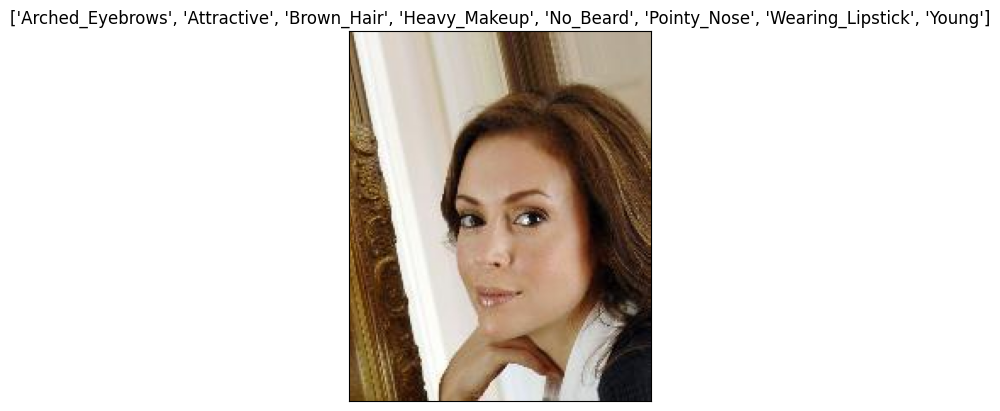

In [3]:
num_workers = 0
# how many samples per batch to load
batch_size = 64

train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size, num_workers=num_workers, shuffle=True)
valid_loader = torch.utils.data.DataLoader(valid_data, batch_size=batch_size, num_workers=num_workers, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_data, batch_size=batch_size, num_workers=num_workers, shuffle=True)

classes = ['5_o_Clock_Shadow','Arched_Eyebrows', 'Attractive', 'Bags_Under_Eyes','Bald', 'Bangs', 'Big_Lips', 'Big_Nose', 'Black_Hair', 'Blond_Hair', 'Blurry', 'Brown_Hair', 'Bushy_Eyebrows', 'Chubby', 'Double_Chin',
        'Eyeglasses', 'Goatee', 'Gray_Hair', 'Heavy_Makeup', 'High_Cheekbones', 'Male', 'Mouth_Slightly_Open', 'Mustache', 'Narrow_Eyes', 'No_Beard', 'Oval_Face', 'Pale_Skin', 'Pointy_Nose', 'Receding_Hairline',
        'Rosy_Cheeks', 'Sideburns', 'Smiling', 'Straight_Hair', 'Wavy_Hair', 'Wearing_Earrings', 'Wearing_Hat', 'Wearing_Lipstick', 'Wearing_Necklace', 'Wearing_Necktie', 'Young']

dataiter = iter(train_loader)
images, labels = next(dataiter)

print(images.shape)


imshow_with_encoded_labels(1, images, labels, classes)

    
    

## Conditional Variational Autoencoder Architecture

In [4]:
class CVAE(nn.Module):
    def __init__(self, latent_size = 128, num_classes = 40):
        
        super(CVAE, self).__init__()
        
        self.mu=None
        self.logvar=None
        self.latent_size = latent_size
        self.num_classes = num_classes
        
        self.encoder = nn.Sequential(
            nn.Conv2d(3 + self.num_classes, 16, kernel_size=3, padding=1),
            # nn.BatchNorm2d(16),
            nn.ReLU(),
            
            nn.MaxPool2d(kernel_size=2, stride=2),
            
            nn.Conv2d(16, 8, kernel_size=3, padding=1),
            # nn.BatchNorm2d(8),
            nn.ReLU(),
            
            nn.MaxPool2d(kernel_size=2, stride=2)
        )
        
        self.mu_fc = nn.Linear(8*54*44, self.latent_size)
        
        self.logvar_fc = nn.Linear(8*54*44, self.latent_size)
        
        self.z_fc = nn.Linear(self.latent_size + self.num_classes, 8*54*44) 
        
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(8, 16, kernel_size=3, stride=2),
            # nn.BatchNorm2d(16),
            nn.ReLU(),
            
            nn.ConvTranspose2d(16, 3, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid()
        )
        
    def encode(self, x, y):
        y = y.reshape(y.shape[0], self.num_classes, 1, 1).repeat(1, 1, 218, 178)
        
        x = torch.cat([x,y], dim=1)
        x = self.encoder(x)
        x = x.view(x.size(0), -1)        
        mu = self.mu_fc(x)
        logvar = self.logvar_fc(x)
        
        return mu, logvar

    def reparam(self, mu, logvar):
        
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        
        z = mu + eps * std
        return z
    
    
    def decode(self, z, y):
        # y = y.reshape(y.shape[0], self.num_classes, 1, 1).repeat(1, 1, 54, 44)
        # print_np_array_properties(y)
        
        z = torch.cat([z, y.view(y.size(0),-1)], dim=1)
        # print_np_array_properties(z)
        
        z = self.z_fc(z)
        
        z = z.view(z.size(0), 8, 54, 44)
        
        x = self.decoder(z)
        
        return x
            
    def forward(self, x, y):
        
        self.mu, self.logvar = self.encode(x,y)
        z = self.reparam(self.mu, self.logvar)
        x = self.decode(z, y)
        
        return x, self.mu, self.logvar

# def cvae_loss(x_out, x, mu, logvar, beta=0.5):
    
#     BCE = F.binary_cross_entropy(x_out, x, reduction='sum')
#     KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    
#     return (1-beta)*BCE + beta*KLD

def cvae_loss(x_out, x, mu, logvar, beta=0.5):
    # Reconstruction loss (Mean Squared Error)
    mse_loss = nn.MSELoss(reduction='sum')
    recon_loss = mse_loss(x_out, x)

    # KL-divergence loss
    kl_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

    return (1-beta)*recon_loss + beta*kl_loss


def initialize_weights(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.Linear)):
        nn.init.kaiming_normal_(m.weight, mode='fan_in', nonlinearity='relu')
        if m.bias is not None:
            nn.init.zeros_(m.bias)

### Define Model and optimizer

In [5]:
model = CVAE().to(device)
model.apply(initialize_weights)

print(model)

# print_np_array_properties(images)

x, mu, logvar = model(images.to(device), labels.to(device))


print_np_array_properties(x, 'reconstructed x')
print_np_array_properties(mu, 'mu')
print_np_array_properties(logvar, 'logvar')


loss_func = cvae_loss
optimizer = optim.Adam(model.parameters(), lr=1e-4)

CVAE(
  (encoder): Sequential(
    (0): Conv2d(43, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(16, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): ReLU()
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (mu_fc): Linear(in_features=19008, out_features=128, bias=True)
  (logvar_fc): Linear(in_features=19008, out_features=128, bias=True)
  (z_fc): Linear(in_features=168, out_features=19008, bias=True)
  (decoder): Sequential(
    (0): ConvTranspose2d(8, 16, kernel_size=(3, 3), stride=(2, 2))
    (1): ReLU()
    (2): ConvTranspose2d(16, 3, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
    (3): Sigmoid()
  )
)
=============== reconstructed x Properties =============

reconstructed x:
 tensor([[[[0.6355, 0.6893, 0.3041,  ..., 0.6733, 0.6034, 0.3733],
          [0.6464, 0.6419, 0.3846,

### Training

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 1 	Training Loss: 38182.735371 	Validation Loss: 22702.002383
Validation loss decreased (inf --> 22702.002383).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 2 	Training Loss: 20964.129893 	Validation Loss: 19594.281074
Validation loss decreased (22702.002383 --> 19594.281074).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 3 	Training Loss: 18738.275951 	Validation Loss: 18757.638180
Validation loss decreased (19594.281074 --> 18757.638180).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 4 	Training Loss: 17601.666947 	Validation Loss: 17082.188217
Validation loss decreased (18757.638180 --> 17082.188217).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 5 	Training Loss: 16823.863354 	Validation Loss: 16511.195238
Validation loss decreased (17082.188217 --> 16511.195238).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 6 	Training Loss: 16323.251979 	Validation Loss: 16134.704676
Validation loss decreased (16511.195238 --> 16134.704676).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 7 	Training Loss: 16019.614698 	Validation Loss: 15907.198649
Validation loss decreased (16134.704676 --> 15907.198649).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 8 	Training Loss: 15808.678463 	Validation Loss: 15712.363999
Validation loss decreased (15907.198649 --> 15712.363999).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 9 	Training Loss: 15651.689216 	Validation Loss: 15694.642291
Validation loss decreased (15712.363999 --> 15694.642291).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 10 	Training Loss: 15530.953093 	Validation Loss: 15448.097930
Validation loss decreased (15694.642291 --> 15448.097930).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 11 	Training Loss: 15438.958608 	Validation Loss: 15378.946383
Validation loss decreased (15448.097930 --> 15378.946383).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 12 	Training Loss: 15359.274727 	Validation Loss: 15301.449655
Validation loss decreased (15378.946383 --> 15301.449655).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 13 	Training Loss: 15287.815576 	Validation Loss: 15281.175990
Validation loss decreased (15301.449655 --> 15281.175990).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 14 	Training Loss: 15222.145952 	Validation Loss: 15160.649636
Validation loss decreased (15281.175990 --> 15160.649636).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 15 	Training Loss: 15161.717353 	Validation Loss: 15147.415980
Validation loss decreased (15160.649636 --> 15147.415980).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 16 	Training Loss: 15113.583533 	Validation Loss: 15099.569131
Validation loss decreased (15147.415980 --> 15099.569131).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 17 	Training Loss: 15066.196291 	Validation Loss: 15035.342234
Validation loss decreased (15099.569131 --> 15035.342234).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 18 	Training Loss: 15027.849373 	Validation Loss: 15016.516874
Validation loss decreased (15035.342234 --> 15016.516874).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 19 	Training Loss: 14997.298953 	Validation Loss: 15060.211433


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 20 	Training Loss: 14963.244999 	Validation Loss: 14949.773089
Validation loss decreased (15016.516874 --> 14949.773089).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 21 	Training Loss: 14931.406021 	Validation Loss: 15015.376329


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 22 	Training Loss: 14907.228532 	Validation Loss: 15102.507148


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 23 	Training Loss: 14880.195048 	Validation Loss: 14859.429696
Validation loss decreased (14949.773089 --> 14859.429696).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 24 	Training Loss: 14859.186100 	Validation Loss: 14829.905525
Validation loss decreased (14859.429696 --> 14829.905525).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 25 	Training Loss: 14835.153624 	Validation Loss: 14773.775640
Validation loss decreased (14829.905525 --> 14773.775640).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 26 	Training Loss: 14814.097076 	Validation Loss: 14758.736394
Validation loss decreased (14773.775640 --> 14758.736394).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 27 	Training Loss: 14794.247971 	Validation Loss: 14779.188153


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 28 	Training Loss: 14776.035160 	Validation Loss: 14841.535521


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 29 	Training Loss: 14758.171127 	Validation Loss: 14736.039269
Validation loss decreased (14758.736394 --> 14736.039269).  Saving model ...


  0%|          | 0/2544 [00:00<?, ?it/s]

  0%|          | 0/311 [00:00<?, ?it/s]

Epoch: 30 	Training Loss: 14740.753913 	Validation Loss: 14707.776360
Validation loss decreased (14736.039269 --> 14707.776360).  Saving model ...


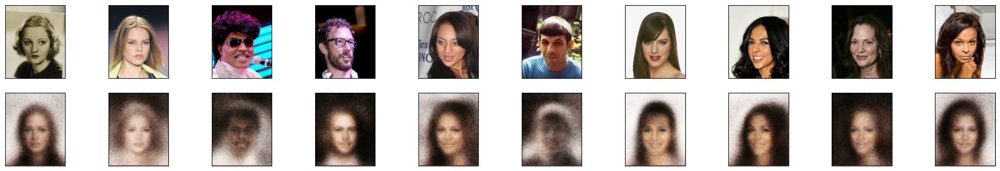

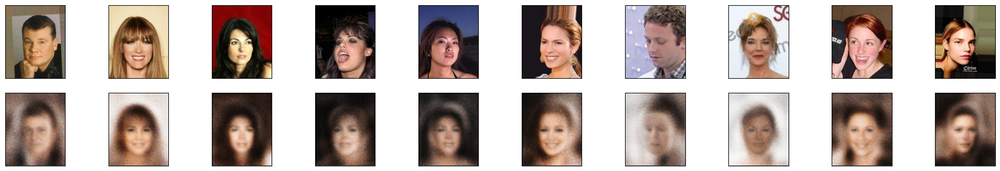

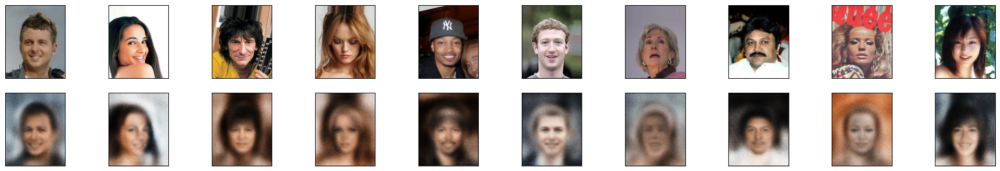

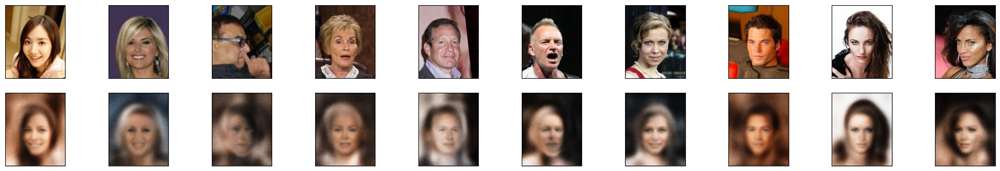

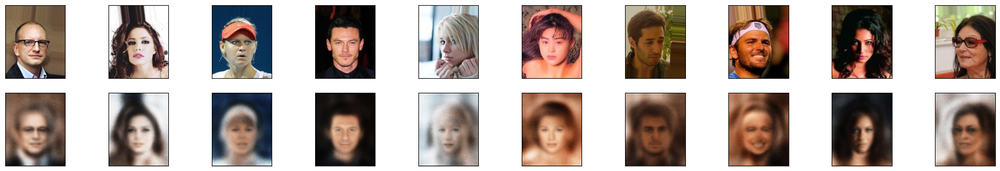

...

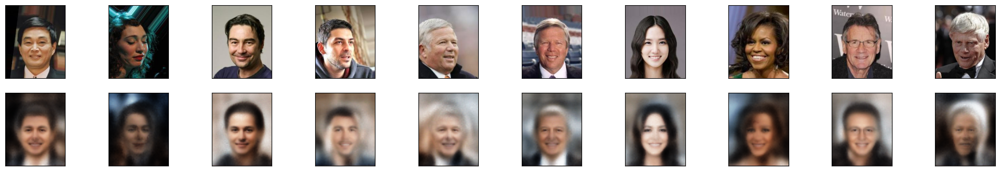

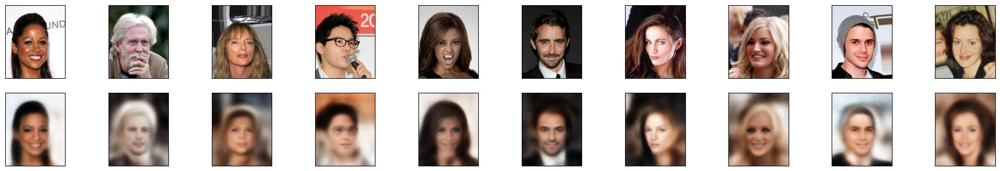

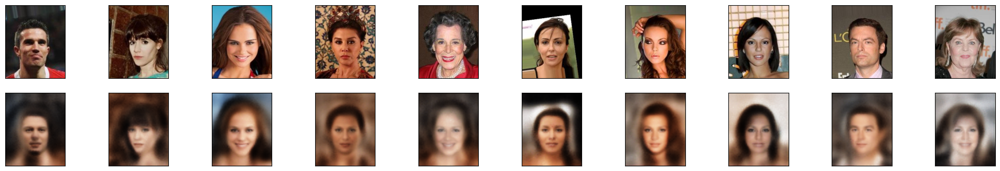

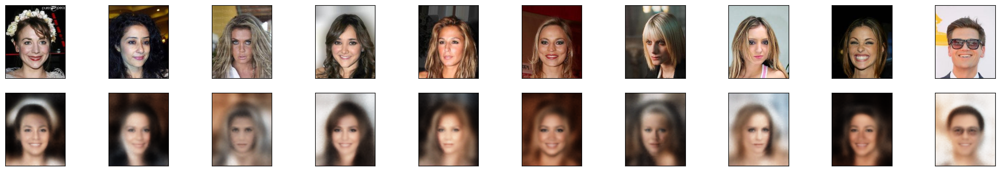

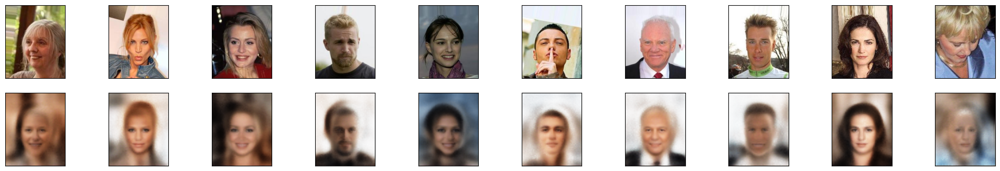

In [6]:
n_epochs=30
ts = datetime.datetime.now().strftime(str_format)
beta = 0.9

valid_loss_min = np.Inf

for epoch in trange(1, n_epochs+1):
    
    train_loss=0.0
    valid_loss=0.0
    
    ## Training Step
    model.train()
    for images, labels in tqdm(train_loader):
        
        images, labels = images.to(device), labels.to(device)
        
        optimizer.zero_grad() # clar the gradients of all optimized variables
        x_out, mu, logvar = model(images, labels) # Forward pass
        
        loss = loss_func(x_out, images, mu, logvar, beta=beta) # calculate loss of the forward pass
        
        loss.backward() #calculate gradients based on the loss
        
        optimizer.step() # update weights
        
        train_loss += loss.item()*images.size(0)
    ## Validation Step
    
    model.eval()
    for images, labels in tqdm(valid_loader):
        images, labels = images.to(device), labels.to(device)
        
        x_out, mu, logvar = model(images, labels) # forward pass
        
        loss = loss_func(x_out, images, mu, logvar, beta=beta)
        
        valid_loss += loss.item() * images.size(0)
    
    # calculate Average loss
    train_loss = train_loss/len(train_loader.dataset) 
    valid_loss = valid_loss/len(valid_loader.dataset)
    
    #Print progress statement
    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(epoch, train_loss, valid_loss))
    
    #Test after ach epoch
    # obtain one batch of test images
    dataiter = iter(test_loader)
    images, labels = next(dataiter)
    view_size = 10 if batch_size >=10 else batch_size
    images = images[:view_size]
    labels = labels[:view_size]

    # get sample outputs
    output, _, _ = model(images.to(device), labels.to(device))
    # prep images for display
    images = images.numpy()

    # output is resized into a batch of iages
    output = output.to('cpu').view(view_size, 3, 218, 178)
    # use detach when it's an output that requires_grad
    output = output.detach().numpy()

    # plot the first ten input images and then reconstructed images
    fig, axes = plt.subplots(nrows=2, ncols=10, sharex=True, sharey=True, figsize=(25,4))

    # input images on top row, reconstructions on bottom
    for images, row in zip([images, output], axes):
        for img, ax in zip(images, row):
            ax.imshow(np.transpose(img, (1,2,0)))
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)
    
    
    #Save model with the lowest validation loss
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(valid_loss_min, valid_loss))
        torch.save(model.state_dict(), f'./data/CVAE_celebA_{ts}.pt')
        valid_loss_min = valid_loss

### Sample Distribution p(Z|Y) to generate a new face

['Blond_Hair', 'High_Cheekbones', 'Mouth_Slightly_Open', 'No_Beard', 'Smiling', 'Straight_Hair', 'Wearing_Earrings', 'Wearing_Lipstick', 'Young']
attributes: ['Blond_Hair', 'High_Cheekbones', 'Mouth_Slightly_Open', 'No_Beard', 'Smiling', 'Straight_Hair', 'Wearing_Earrings', 'Wearing_Lipstick', 'Young']
=============== latent code Properties =============

latent code:
 tensor([[ 1.4720, -0.1605,  0.5515,  ..., -0.1914, -0.4697,  0.7565],
        [ 0.2384,  1.7455,  0.0468,  ...,  0.1945, -1.5649,  0.9456],
        [ 0.5705, -1.1435,  0.1784,  ...,  0.1944,  0.0690,  0.2343],
        ...,
        [-0.7685, -0.8079, -1.2261,  ...,  1.3279,  0.2865, -0.9119],
        [ 0.7161,  1.4145, -0.0338,  ...,  1.0304, -0.5384,  0.7957],
        [ 0.0646, -0.0519, -2.0821,  ...,  0.3923,  0.7159, -0.5527]],
       device='cuda:0')
latent code_dtype: torch.float32
latent code_shape: torch.Size([50, 128])
latent code_size: <built-in method size of Tensor object at 0x7f1319fbc810>



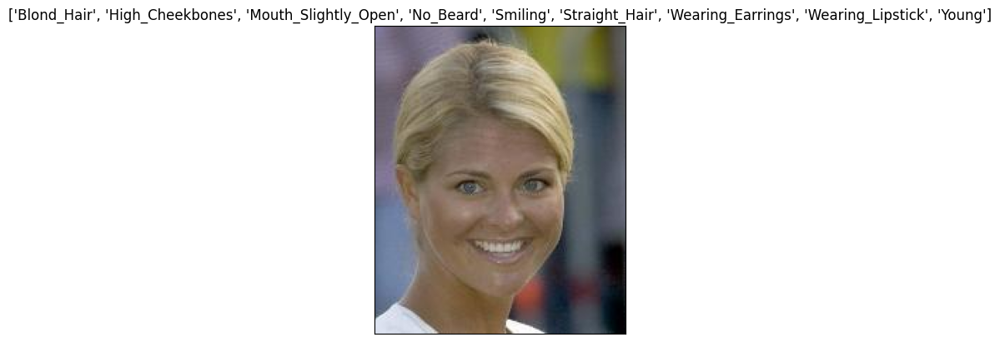

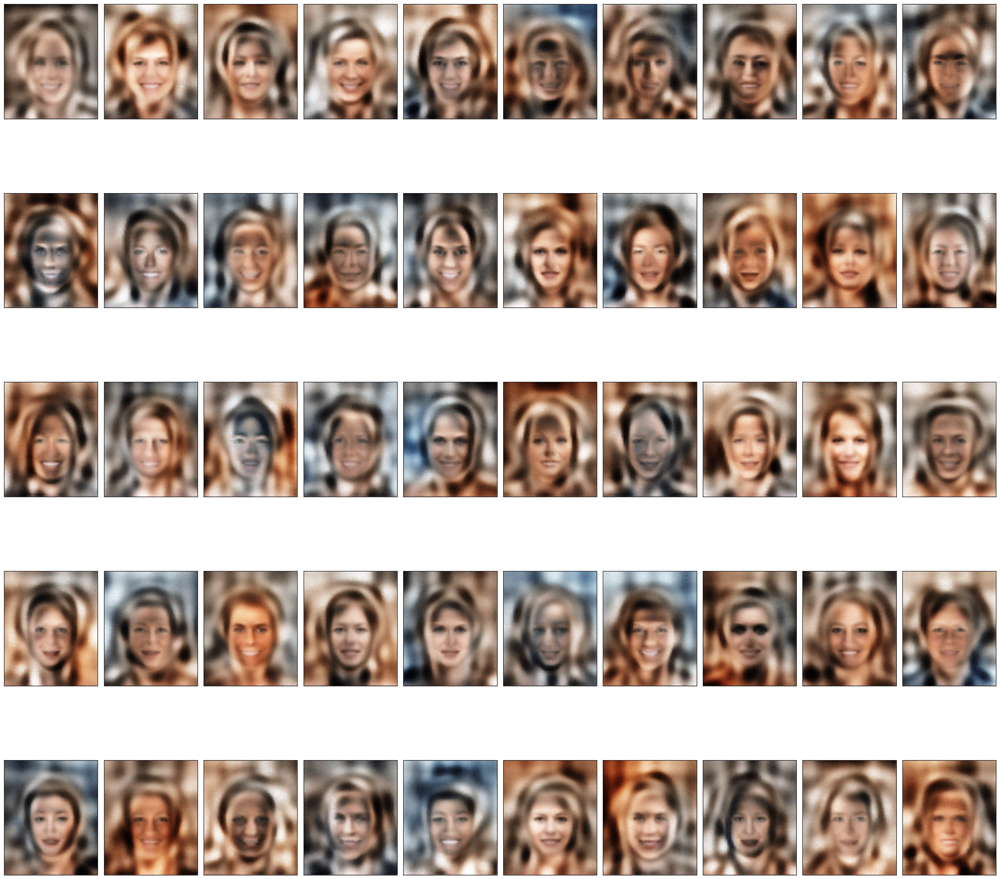

In [7]:
model = CVAE().to(device)
model.load_state_dict(torch.load('./data/CVAE_celebA_20230411232438_MSE_50percent.pt'))
        
group_size = 50
latent_size = model.latent_size 
z = torch.randn(group_size, latent_size).to(device)

dataiter = iter(test_loader)
images, labels = next(dataiter)

label = labels[0]
label_batch = label.reshape(1, model.num_classes).repeat(group_size, 1)

imshow_with_encoded_labels(1, images, labels, classes)
attr = get_encoded_attrs(classes, label)

print(f'attributes: {attr}')

print_np_array_properties(z, name='latent code')

# generate an image from the random latent vector using the decoder
model.eval()
with torch.no_grad():
    output = model.decode(z, label_batch.to(device))
    
output = output.to('cpu')

imshow_batch(group_size, output)


#### This Cell is to print attributes

In [8]:
print(classes)

['5_o_Clock_Shadow', 'Arched_Eyebrows', 'Attractive', 'Bags_Under_Eyes', 'Bald', 'Bangs', 'Big_Lips', 'Big_Nose', 'Black_Hair', 'Blond_Hair', 'Blurry', 'Brown_Hair', 'Bushy_Eyebrows', 'Chubby', 'Double_Chin', 'Eyeglasses', 'Goatee', 'Gray_Hair', 'Heavy_Makeup', 'High_Cheekbones', 'Male', 'Mouth_Slightly_Open', 'Mustache', 'Narrow_Eyes', 'No_Beard', 'Oval_Face', 'Pale_Skin', 'Pointy_Nose', 'Receding_Hairline', 'Rosy_Cheeks', 'Sideburns', 'Smiling', 'Straight_Hair', 'Wavy_Hair', 'Wearing_Earrings', 'Wearing_Hat', 'Wearing_Lipstick', 'Wearing_Necklace', 'Wearing_Necktie', 'Young']


###  Sample Distribution p(Z|X) to generate a new face (Custom)

=============== latent code Properties =============

latent code:
 tensor([[ 5.7261e-01, -4.4237e-01,  2.9999e-01,  ...,  7.2826e-01,
          1.2172e+00, -1.1758e+00],
        [ 2.0926e-01,  1.8381e+00,  4.1163e-01,  ..., -7.5309e-01,
          1.2791e+00,  1.5337e-02],
        [ 1.5288e+00, -4.0003e-01,  9.7684e-01,  ..., -3.8292e-01,
          2.2771e-01,  5.7075e-01],
        ...,
        [-2.7748e-01,  1.5048e-04,  2.0204e+00,  ..., -9.8238e-01,
         -1.0924e+00,  4.4362e-01],
        [ 6.4099e-01, -1.8801e+00,  1.5983e-01,  ..., -3.1252e-01,
          7.1757e-01,  1.2076e-01],
        [-2.4045e+00,  5.9766e-01,  1.1023e+00,  ...,  5.4999e-01,
          4.9375e-01, -1.8276e-01]], device='cuda:0')
latent code_dtype: torch.float32
latent code_shape: torch.Size([100, 128])
latent code_size: <built-in method size of Tensor object at 0x7f1329ba8b30>

Attributes to reproduce:
['Attractive', 'Big_Nose', 'Black_Hair', 'Mouth_Slightly_Open', 'Pointy_Nose', 'Sideburns', 'Smiling', 'Wa

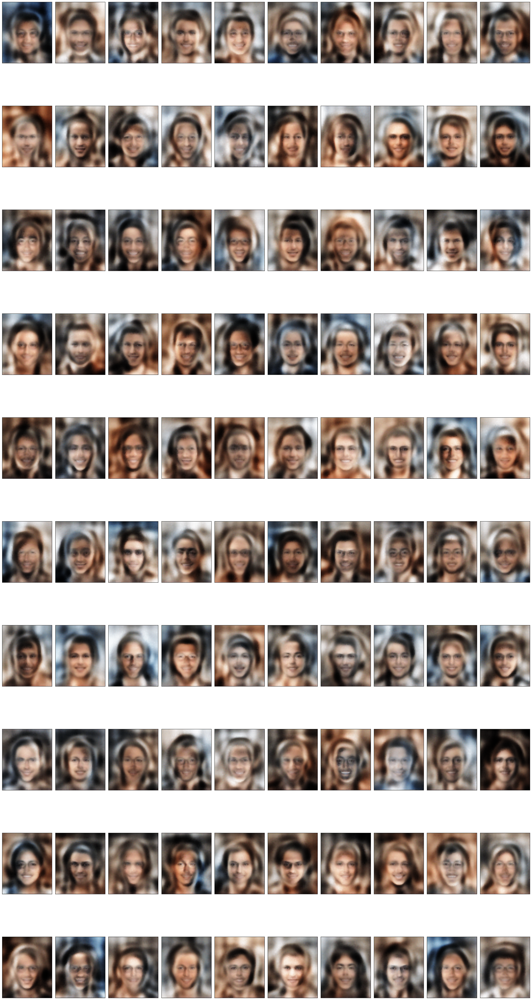

In [9]:
model = CVAE().to(device)
model.load_state_dict(torch.load('./data/CVAE_celebA_20230410194212_90percentkld2.pt'))
# model.load_state_dict(torch.load('./data/CVAE_celebA_20230412010502_MSE_75percent.pt'))
# model.load_state_dict(torch.load('./data/CVAE_celebA_20230411232438_MSE_50percent.pt'))
# model.load_state_dict(torch.load('./data/CVAE_celebA_20230411130854_25percent.pt'))

        
group_size = 100
latent_size = model.latent_size 

z = torch.randn(group_size, latent_size).to(device)

print_np_array_properties(z, name='latent code')


custom_attrs = ['Attractive', 'Big_Nose', 'Black_Hair', 'Mouth_Slightly_Open', 'Pointy_Nose', 'Sideburns', 'Smiling', 'Wavy_Hair', 'Eyeglasses']

print(f'Attributes to reproduce:\n{custom_attrs}')


custom_label = torch.tensor(encode_attrs(custom_attrs, classes))

custom_label_batch = custom_label.reshape(1, model.num_classes).repeat(group_size, 1)

# generate an image from the random latent vector using the decoder
model.eval()
with torch.no_grad():
    custom_output = model.decode(z, custom_label_batch.to(device))
    
custom_output = custom_output.to('cpu')

imshow_batch(group_size, custom_output)